# Proyek Analisis Data: Bike Sharing Dataset
- **Nama:** Andika Faliyastats Yunus
- **Email:** andika.22105@mhs.unesa.ac.id
- **ID Dicoding:** andikaifal

## Menentukan Pertanyaan Bisnis

- Pertanyaan 1: Faktor-faktor apa saja yang mempengaruhi jumlah peminjaman sepeda setiap harinya?
- Pertanyaan 2: Bagaimana tren penggunaan sepeda sepanjang hari dan apakah ada jam tertentu yang menjadi puncak peminjaman?

## Import Semua Packages/Library yang Digunakan

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
!pip install streamlit
import streamlit as st
import zipfile
import datetime as dt
!pip install geopandas folium
import geopandas as gpd
import folium

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 63.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 84.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.9/82.9 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 3.9 MB/s eta 0:00:00
  Attempting uninstall: tenacity
    Found existing installation: tenacity 9.0.0
    Uninstalling tenacity-9.0.0:
      Successfully uninstalled tenacity-9.0.0


## Data Wrangling

### Gathering Data

In [ ]:
!kaggle datasets download -d lakshmi25npathi/bike-sharing-dataset

Dataset URL: https://www.kaggle.com/datasets/lakshmi25npathi/bike-sharing-dataset
License(s): unknown
  0% 0.00/286k [00:00<?, ?B/s]
100% 286k/286k [00:00<00:00, 58.7MB/s]


In [7]:
zip_ref = zipfile.ZipFile('bike-sharing-dataset.zip', 'r')
zip_ref.extractall('datasets/')
zip_ref.close()

In [8]:
df_day = pd.read_csv('datasets/day.csv')
df_day.head()

,instant,dteday,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985
1,2,2011-01-02,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801
2,3,2011-01-03,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349
3,4,2011-01-04,1,0,1,0,2,1,1,0.200000,0.212122,0.590435,0.160296,108,1454,1562
4,5,2011-01-05,1,0,1,0,3,1,1,0.226957,0.229270,0.436957,0.186900,82,1518,1600


In [9]:
df_hour = pd.read_csv('datasets/hour.csv')
df_hour.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


### Assessing Data

In [10]:
df_day.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 731 entries, 0 to 730
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   instant     731 non-null    int64  
 1   dteday      731 non-null    object 
 2   season      731 non-null    int64  
 3   yr          731 non-null    int64  
 4   mnth        731 non-null    int64  
 5   holiday     731 non-null    int64  
 6   weekday     731 non-null    int64  
 7   workingday  731 non-null    int64  
 8   weathersit  731 non-null    int64  
 9   temp        731 non-null    float64
 10  atemp       731 non-null    float64
 11  hum         731 non-null    float64
 12  windspeed   731 non-null    float64
 13  casual      731 non-null    int64  
 14  registered  731 non-null    int64  
 15  cnt         731 non-null    int64  
dtypes: float64(4), int64(11), object(1)
memory usage: 91.5+ KB


In [11]:
df_hour.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 17 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   instant     17379 non-null  int64  
 1   dteday      17379 non-null  object 
 2   season      17379 non-null  int64  
 3   yr          17379 non-null  int64  
 4   mnth        17379 non-null  int64  
 5   hr          17379 non-null  int64  
 6   holiday     17379 non-null  int64  
 7   weekday     17379 non-null  int64  
 8   workingday  17379 non-null  int64  
 9   weathersit  17379 non-null  int64  
 10  temp        17379 non-null  float64
 11  atemp       17379 non-null  float64
 12  hum         17379 non-null  float64
 13  windspeed   17379 non-null  float64
 14  casual      17379 non-null  int64  
 15  registered  17379 non-null  int64  
 16  cnt         17379 non-null  int64  
dtypes: float64(4), int64(12), object(1)
memory usage: 2.3+ MB


In [13]:
print(f'Total duplikat di df_day: {df_day.duplicated().sum()}')
print(f'Total duplikat di df_hour: {df_hour.duplicated().sum()}')

Total duplikat di df_day: 0
Total duplikat di df_hour: 0


### Cleaning Data

In [ ]:
df_day['dteday'] = pd.to_datetime(df_day['dteday'])
df_hour['dteday'] = pd.to_datetime(df_hour['dteday'])

Q1 = df_day[['temp', 'atemp', 'hum', 'windspeed']].quantile(0.25)
Q3 = df_day[['temp', 'atemp', 'hum', 'windspeed']].quantile(0.75)
IQR = Q3 - Q1

df_day = df_day[~((df_day[['temp', 'atemp', 'hum', 'windspeed']] < (Q1 - 1.5 * IQR)) | (df_day[['temp', 'atemp', 'hum', 'windspeed']] > (Q3 + 1.5 * IQR))).any(axis=1)]

Q1_hour = df_hour[['temp', 'atemp', 'hum', 'windspeed']].quantile(0.25)
Q3_hour = df_hour[['temp', 'atemp', 'hum', 'windspeed']].quantile(0.75)
IQR_hour = Q3_hour - Q1_hour

df_hour = df_hour[~((df_hour[['temp', 'atemp', 'hum', 'windspeed']] < (Q1_hour - 1.5 * IQR_hour)) | (df_hour[['temp', 'atemp', 'hum', 'windspeed']] > (Q3_hour + 1.5 * IQR_hour))).any(axis=1)]

## Exploratory Data Analysis (EDA)

### Explore ...

In [ ]:
df_day.head()

,instant,dteday,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985
1,2,2011-01-02,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801
2,3,2011-01-03,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349
3,4,2011-01-04,1,0,1,0,2,1,1,0.200000,0.212122,0.590435,0.160296,108,1454,1562
4,5,2011-01-05,1,0,1,0,3,1,1,0.226957,0.229270,0.436957,0.186900,82,1518,1600


In [ ]:
df_day.describe(include='all')

,instant,dteday,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
count,717.000000,717,717.00000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000,717.000000
mean,366.779637,2012-01-01 18:42:40.669455872,2.51325,0.499303,6.562064,0.029289,2.995816,0.684798,1.396095,0.497365,0.476252,0.631562,0.186287,856.944212,3675.899582,4532.843794
min,1.000000,2011-01-01 00:00:00,1.00000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.059130,0.079070,0.254167,0.022392,2.000000,20.000000,22.000000
25%,185.000000,2011-07-04 00:00:00,2.00000,0.000000,4.000000,0.000000,1.000000,0.000000,1.000000,0.337500,0.337939,0.524583,0.134329,318.000000,2545.000000,3214.000000
50%,365.000000,2011-12-31 00:00:00,3.00000,0.000000,7.000000,0.000000,3.000000,1.000000,1.000000,0.505833,0.491783,0.630833,0.178496,727.000000,3681.000000,4570.000000
75%,550.000000,2012-07-03 00:00:00,3.00000,1.000000,10.000000,0.000000,5.000000,1.000000,2.000000,0.656667,0.611121,0.732917,0.230721,1120.000000,4807.000000,6031.000000
max,731.000000,2012-12-31 00:00:00,4.00000,1.000000,12.000000,1.000000,6.000000,1.000000,3.000000,0.861667,0.840896,0.972500,0.378108,3410.000000,6946.000000,8714.000000
std,210.971354,NaN,1.10555,0.500349,3.439113,0.168732,2.001741,0.464921,0.543511,0.183617,0.163155,0.139222,0.071786,689.273998,1557.676255,1933.542429


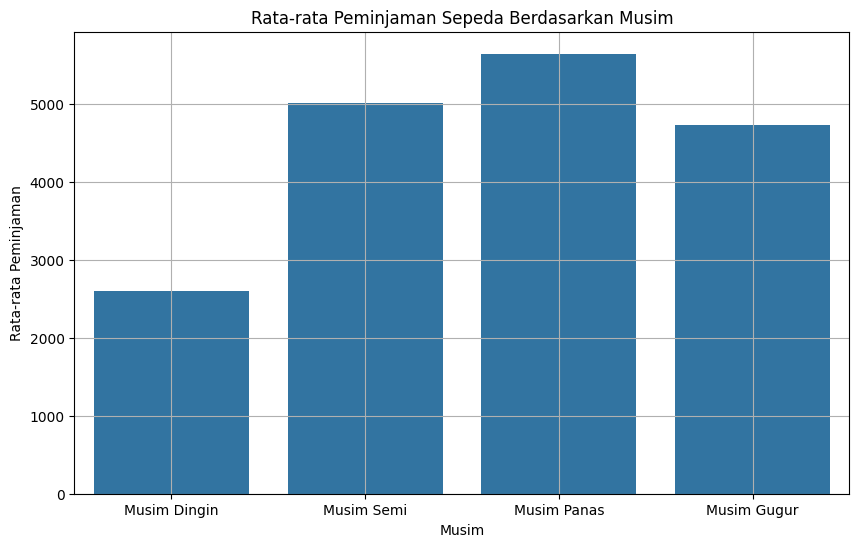

In [ ]:
season_avg = df_day.groupby('season')['cnt'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(data=season_avg, x='season', y='cnt')
plt.title('Rata-rata Peminjaman Sepeda Berdasarkan Musim')
plt.xlabel('Musim')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(ticks=range(4), labels=['Musim Dingin', 'Musim Semi', 'Musim Panas', 'Musim Gugur'])
plt.grid()
plt.show()

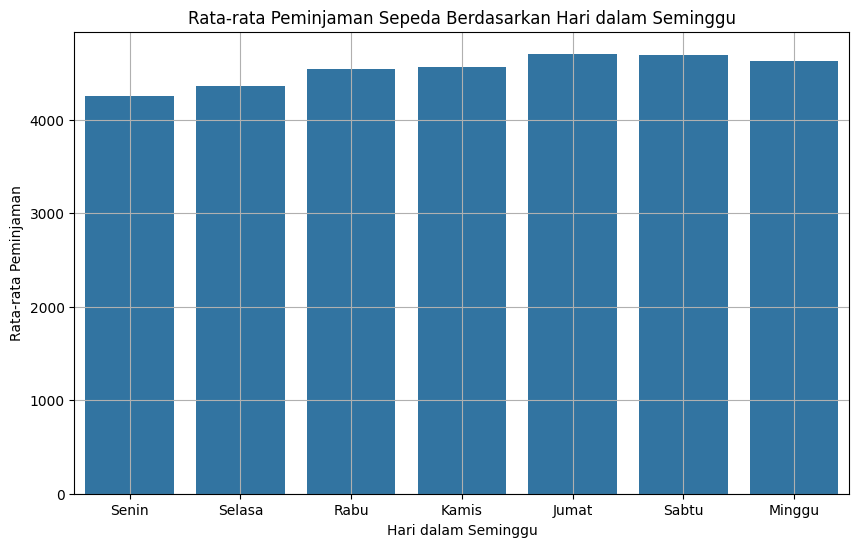

In [ ]:
weekday_avg = df_day.groupby('weekday')['cnt'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(data=weekday_avg, x='weekday', y='cnt')
plt.title('Rata-rata Peminjaman Sepeda Berdasarkan Hari dalam Seminggu')
plt.xlabel('Hari dalam Seminggu')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(ticks=range(7), labels=['Senin', 'Selasa', 'Rabu', 'Kamis', 'Jumat', 'Sabtu', 'Minggu'])
plt.grid()
plt.show()

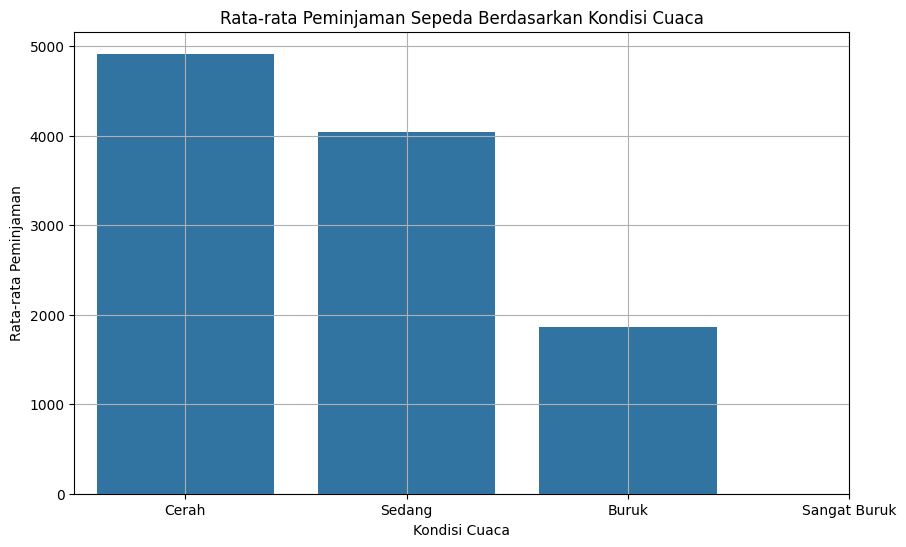

In [ ]:
weather_avg = df_day.groupby('weathersit')['cnt'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(data=weather_avg, x='weathersit', y='cnt')
plt.title('Rata-rata Peminjaman Sepeda Berdasarkan Kondisi Cuaca')
plt.xlabel('Kondisi Cuaca')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(ticks=range(4), labels=['Cerah', 'Sedang', 'Buruk', 'Sangat Buruk'])
plt.grid()
plt.show()

In [ ]:
df_hour.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


In [ ]:
df_hour.describe(include='all')

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
count,17016.000000,17016,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000,17016.000000
mean,8719.636460,2012-01-03 09:56:31.819464192,2.516396,0.502997,6.572873,11.503996,0.028914,2.998002,0.682769,1.422308,0.498235,0.477199,0.630960,0.182814,35.784262,154.048895,189.833157
min,1.000000,2011-01-01 00:00:00,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.020000,0.000000,0.080000,0.000000,0.000000,0.000000,1.000000
25%,4393.750000,2011-07-06 00:00:00,2.000000,0.000000,4.000000,6.000000,0.000000,1.000000,0.000000,1.000000,0.340000,0.333300,0.480000,0.104500,4.000000,34.000000,40.000000
50%,8697.500000,2012-01-03 00:00:00,3.000000,1.000000,7.000000,11.000000,0.000000,3.000000,1.000000,1.000000,0.500000,0.484800,0.635000,0.164200,17.000000,116.000000,142.000000
75%,13075.250000,2012-07-03 06:00:00,3.000000,1.000000,10.000000,18.000000,0.000000,5.000000,1.000000,2.000000,0.660000,0.621200,0.790000,0.253700,48.250000,221.000000,282.000000
max,17379.000000,2012-12-31 00:00:00,4.000000,1.000000,12.000000,23.000000,1.000000,6.000000,1.000000,4.000000,1.000000,1.000000,1.000000,0.462700,367.000000,886.000000,977.000000
std,5009.380243,NaN,1.103448,0.500006,3.427822,6.933561,0.167570,2.005194,0.465412,0.635204,0.192770,0.171556,0.190498,0.112016,49.419374,151.680591,181.762553


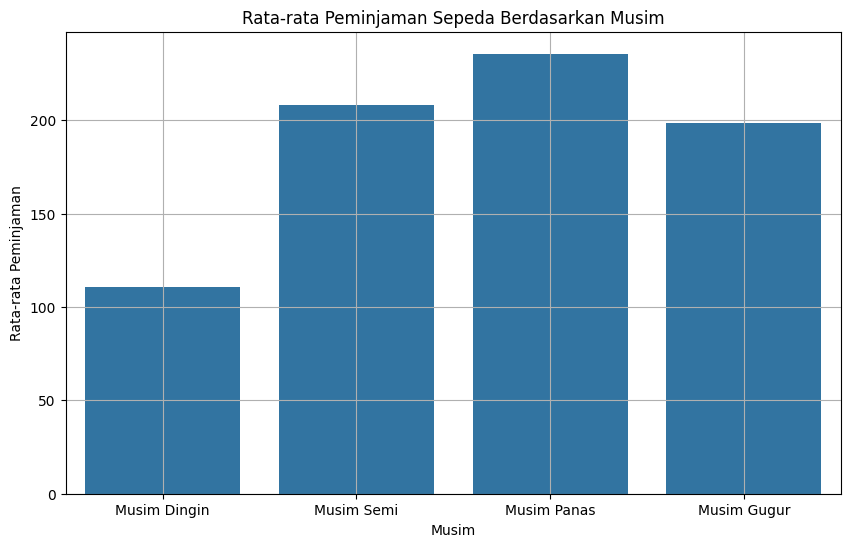

In [ ]:
season_avg = df_hour.groupby('season')['cnt'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(data=season_avg, x='season', y='cnt')
plt.title('Rata-rata Peminjaman Sepeda Berdasarkan Musim')
plt.xlabel('Musim')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(ticks=range(4), labels=['Musim Dingin', 'Musim Semi', 'Musim Panas', 'Musim Gugur'])
plt.grid()
plt.show()

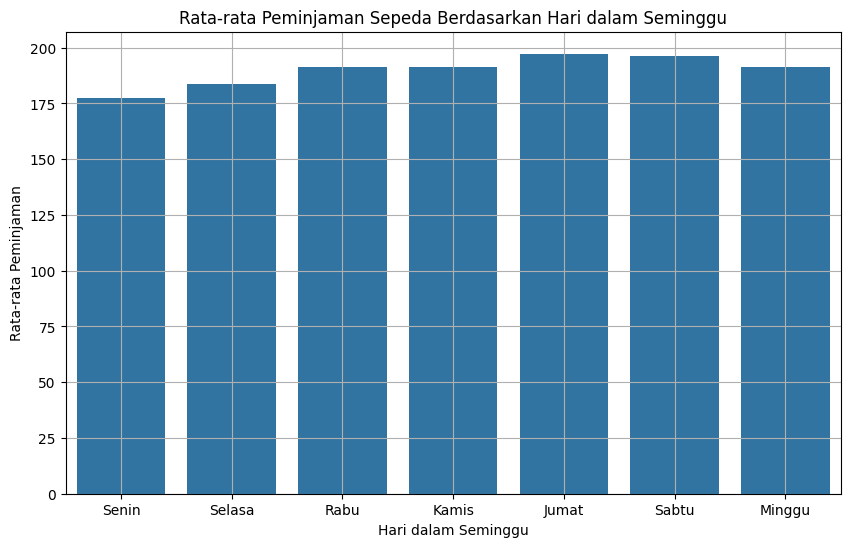

In [ ]:
weekday_avg = df_hour.groupby('weekday')['cnt'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(data=weekday_avg, x='weekday', y='cnt')
plt.title('Rata-rata Peminjaman Sepeda Berdasarkan Hari dalam Seminggu')
plt.xlabel('Hari dalam Seminggu')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(ticks=range(7), labels=['Senin', 'Selasa', 'Rabu', 'Kamis', 'Jumat', 'Sabtu', 'Minggu'])
plt.grid()
plt.show()

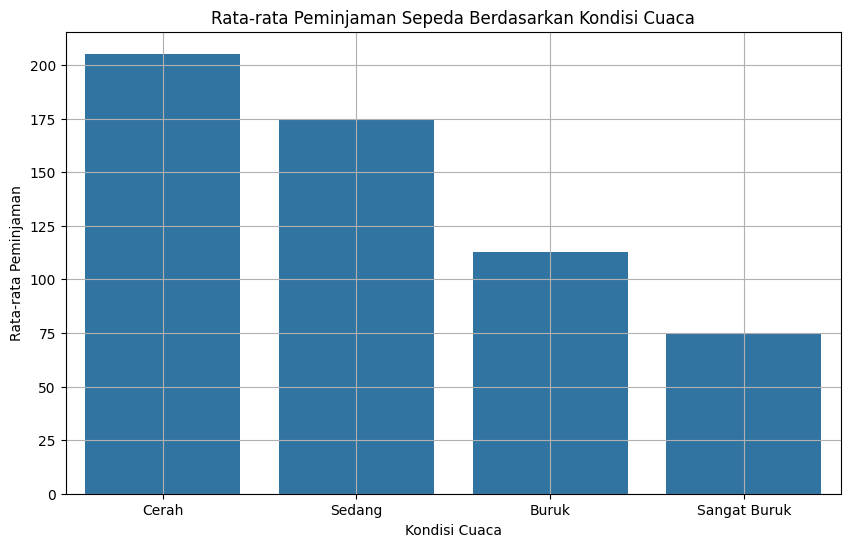

In [ ]:
weather_avg = df_hour.groupby('weathersit')['cnt'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(data=weather_avg, x='weathersit', y='cnt')
plt.title('Rata-rata Peminjaman Sepeda Berdasarkan Kondisi Cuaca')
plt.xlabel('Kondisi Cuaca')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(ticks=range(4), labels=['Cerah', 'Sedang', 'Buruk', 'Sangat Buruk'])
plt.grid()
plt.show()

## Visualization & Explanatory Analysis

### Pertanyaan 1: Faktor-faktor yang Mempengaruhi Peminjaman

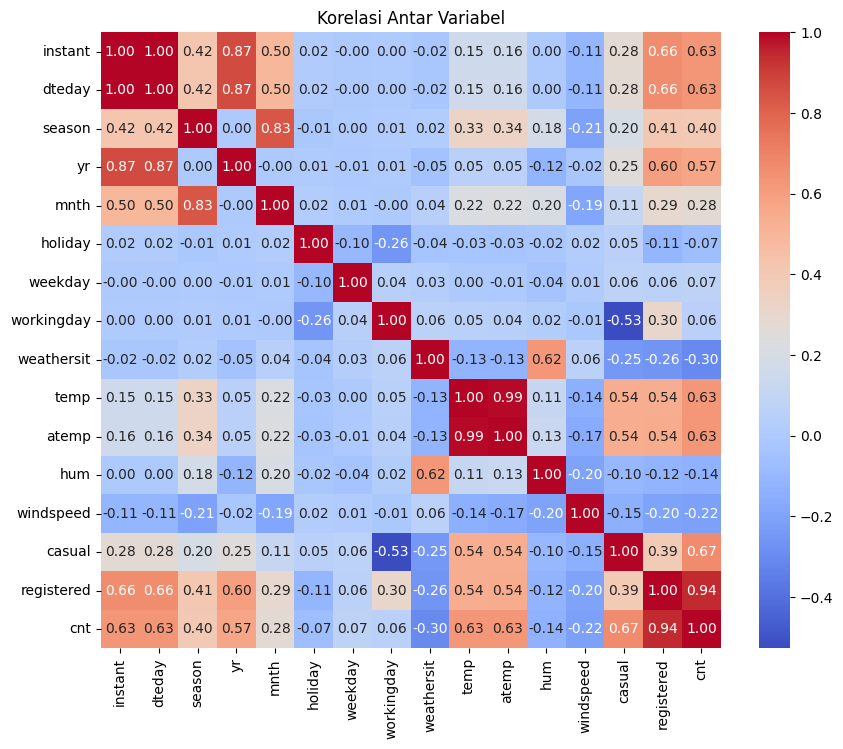

In [ ]:
corr = df_day.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Korelasi Antar Variabel')
plt.show()

### Pertanyaan 2: Tren Penggunaan Sepeda

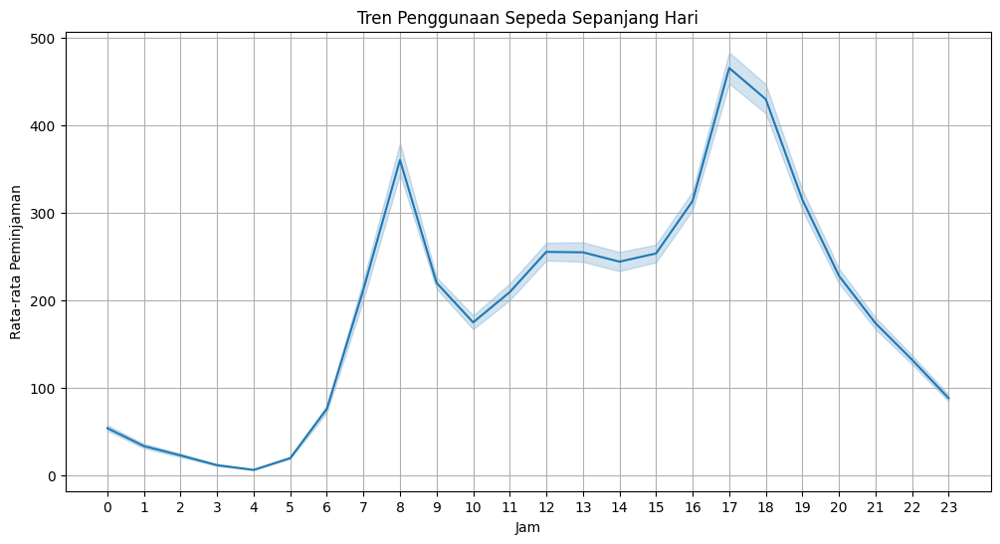

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_hour, x='hr', y='cnt', estimator='mean')
plt.title('Tren Penggunaan Sepeda Sepanjang Hari')
plt.xlabel('Jam')
plt.ylabel('Rata-rata Peminjaman')
plt.xticks(range(0, 24))
plt.grid()
plt.show()

## Analisis Lanjutan (Opsional)

RFM Analisis

In [ ]:
df_day['dteday'] = pd.to_datetime(df_day['dteday'])
snapshot_date = df_day['dteday'].max() + pd.Timedelta(days=1)

r = (snapshot_date - df_day['dteday']).dt.days
f = df_day.groupby('dteday')['cnt'].sum()
m = df_day.groupby('dteday')['cnt'].sum()

rfm_df = pd.DataFrame({'recency': r, 'frequency': f, 'monetary': m})
rfm_df.head()

,recency,frequency,monetary
0,731.0,NaN,NaN
1,730.0,NaN,NaN
2,729.0,NaN,NaN
3,728.0,NaN,NaN
4,727.0,NaN,NaN


Geospatial Analysis

In [ ]:
geometry = gpd.points_from_xy(df_hour.longitude, df_hour.latitude)
geo_df = gpd.GeoDataFrame(df_hour, geometry=geometry)

m = folium.Map(location=[df_hour.latitude.mean(), df_hour.longitude.mean()], zoom_start=12)

for idx, row in geo_df.iterrows():
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']),
        radius=row['cnt'] / 100,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=f"Peminjaman: {row['cnt']}"
    ).add_to(m)

m.save('bike_sharing_map.html')
m

Clustering Analysis

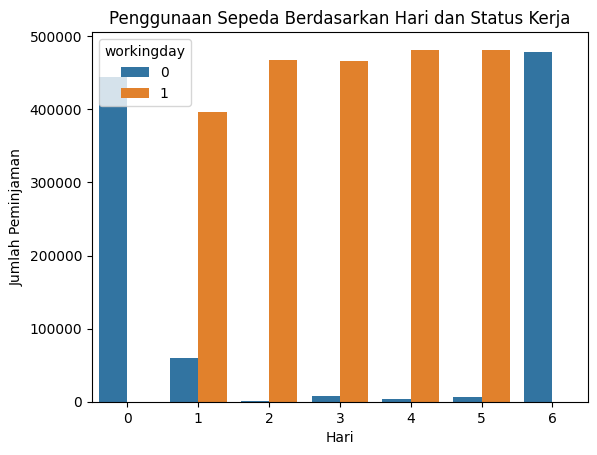

In [15]:
grouped = df_day.groupby(['weekday', 'workingday'])['cnt'].sum().reset_index()
sns.barplot(data=grouped, x='weekday', y='cnt', hue='workingday')
plt.title('Penggunaan Sepeda Berdasarkan Hari dan Status Kerja')
plt.xlabel('Hari')
plt.ylabel('Jumlah Peminjaman')
plt.show()

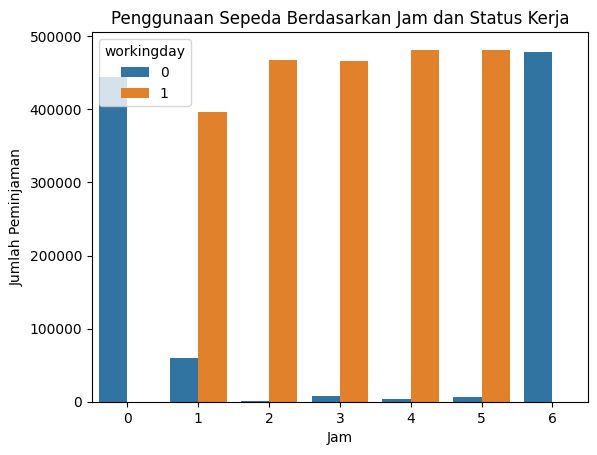

In [14]:
grouped = df_hour.groupby(['weekday', 'workingday'])['cnt'].sum().reset_index()
sns.barplot(data=grouped, x='weekday', y='cnt', hue='workingday')
plt.title('Penggunaan Sepeda Berdasarkan Jam dan Status Kerja')
plt.xlabel('Jam')
plt.ylabel('Jumlah Peminjaman')
plt.show()

## Conclusion

Conclution pertanyaan 1 (Faktor-faktor yang Mempengaruhi Jumlah Peminjaman Sepeda)
1. **Musim**: Data menunjukkan bahwa peminjaman sepeda tertinggi terjadi pada musim panas. Ini mungkin terkait dengan cuaca yang lebih baik dan lebih banyak aktivitas luar ruangan.
2. **Hari dalam Seminggu**: Peminjaman sepeda cenderung lebih tinggi pada hari kerja dibandingkan akhir pekan. Hal ini bisa disebabkan oleh penggunaan sepeda sebagai moda transportasi untuk berangkat kerja atau sekolah.
3. **Kondisi Cuaca**: Cuaca yang cerah berkontribusi signifikan terhadap jumlah peminjaman. Peminjaman cenderung menurun saat cuaca buruk, seperti hujan atau cuaca dingin.
4. **Suhu**: Suhu yang lebih tinggi (baik dari variabel `temp` dan `atemp`) berhubungan positif dengan jumlah peminjaman. Ini menunjukkan bahwa pengguna lebih cenderung menyewa sepeda saat suhu nyaman.

Conclution pertanyaan 2 (Tren Penggunaan Sepeda Sepanjang Hari)
1. **Puncak Penggunaan**: Data menunjukkan bahwa ada puncak penggunaan sepeda pada jam-jam tertentu, dengan jumlah peminjaman tertinggi terjadi antara jam 7 hingga 9 pagi dan jam 5 hingga 7 sore. Ini mencerminkan pola penggunaan sepeda sebagai moda transportasi harian untuk pergi bekerja atau beraktivitas.
2. **Fluktuasi Sepanjang Hari**: Di luar jam-jam puncak tersebut, jumlah peminjaman cenderung menurun, dengan penurunan yang signifikan pada malam hari. Ini menunjukkan bahwa penggunaan sepeda berkurang saat malam hari, mungkin karena kurangnya pencahayaan dan aktivitas luar ruangan.
3. **Ketersediaan Fasilitas**: Puncak penggunaan pada jam-jam tersebut juga bisa dipengaruhi oleh ketersediaan jalur sepeda dan infrastruktur yang mendukung, sehingga pengguna merasa lebih nyaman untuk menggunakan sepeda pada jam-jam tertentu.

